In [19]:
from datetime import datetime
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import requests
import netCDF4
import boto3
import boto3
from botocore import UNSIGNED
from botocore.config import Config
import cartopy.io.shapereader as shpreader
import cartopy.feature as cfeature

%matplotlib inline


In [20]:
bucket_name = 'noaa-goes17'
product_name = 'ABI-L2-AODC'
year = 2020
day_of_year = 235
hour = 1
band = 8

s3_client = boto3.client('s3', config=Config(signature_version=UNSIGNED))
def get_s3_keys(bucket, s3_client, prefix = ''):
    """
    Generate the keys in an S3 bucket.

    :param bucket: Name of the S3 bucket.
    :param prefix: Only fetch keys that start with this prefix (optional).
    """
    
    kwargs = {'Bucket': bucket}

    if isinstance(prefix, str):
        kwargs['Prefix'] = prefix

    while True:
        resp = s3_client.list_objects_v2(**kwargs)
        for obj in resp['Contents']:
            key = obj['Key']
            if key.startswith(prefix):
                yield key

        try:
            kwargs['ContinuationToken'] = resp['NextContinuationToken']
        except KeyError:
            break



# Plot Smoke Map

ABI-L2-AODC/2020/229/00/OR_ABI-L2-AODC
229
ABI-L2-AODC/2020/229/00/OR_ABI-L2-AODC-M6_G17_s20202290001177_e20202290003550_c20202290005251.nc


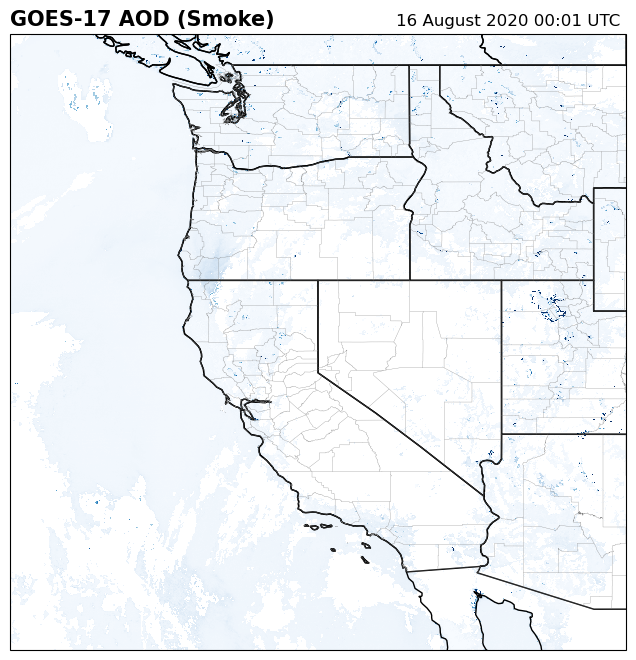

ABI-L2-AODC/2020/229/16/OR_ABI-L2-AODC
229
ABI-L2-AODC/2020/229/16/OR_ABI-L2-AODC-M6_G17_s20202291601176_e20202291603549_c20202291605287.nc


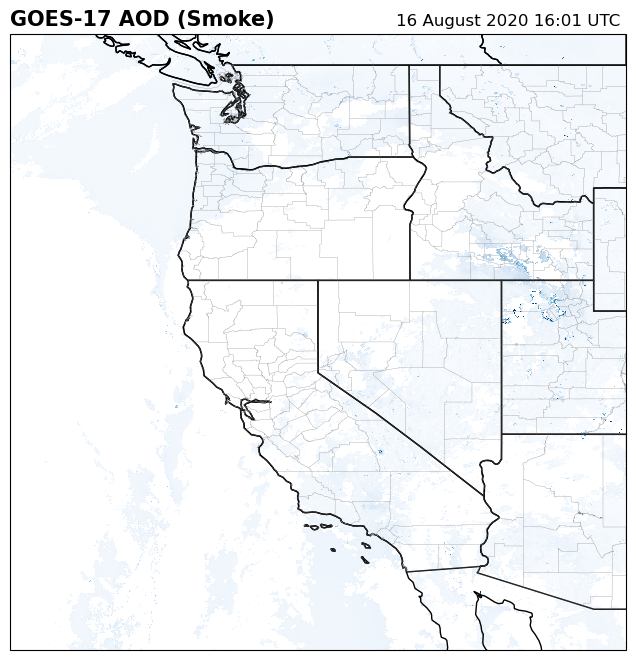

ABI-L2-AODC/2020/229/20/OR_ABI-L2-AODC
229
ABI-L2-AODC/2020/229/20/OR_ABI-L2-AODC-M6_G17_s20202292001176_e20202292003549_c20202292005464.nc


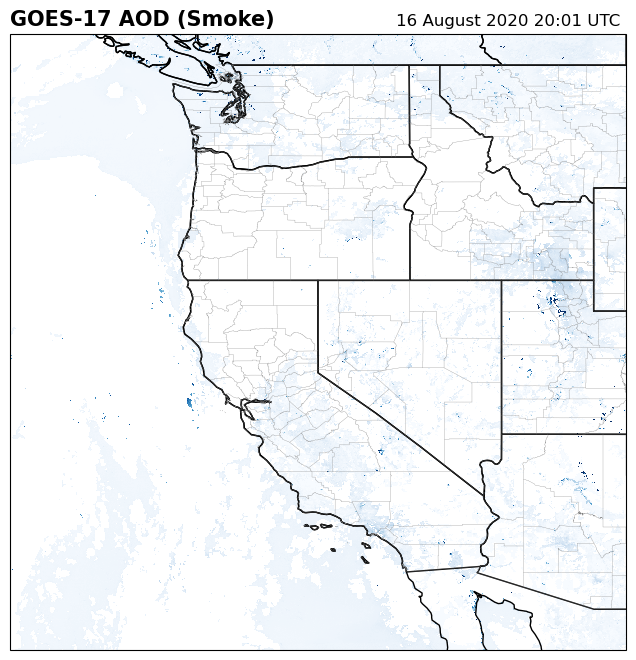

ABI-L2-AODC/2020/230/00/OR_ABI-L2-AODC
230
ABI-L2-AODC/2020/230/00/OR_ABI-L2-AODC-M6_G17_s20202300001176_e20202300003549_c20202300005222.nc


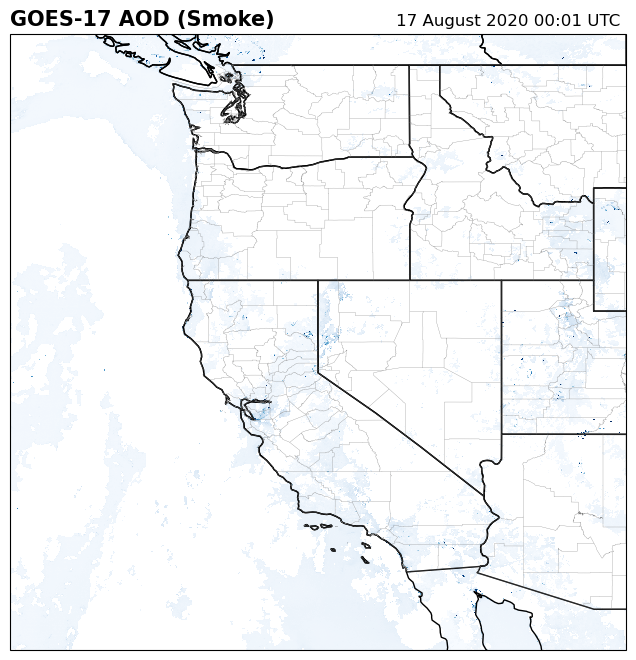

ABI-L2-AODC/2020/230/16/OR_ABI-L2-AODC
230
ABI-L2-AODC/2020/230/16/OR_ABI-L2-AODC-M6_G17_s20202301601176_e20202301603549_c20202301605254.nc


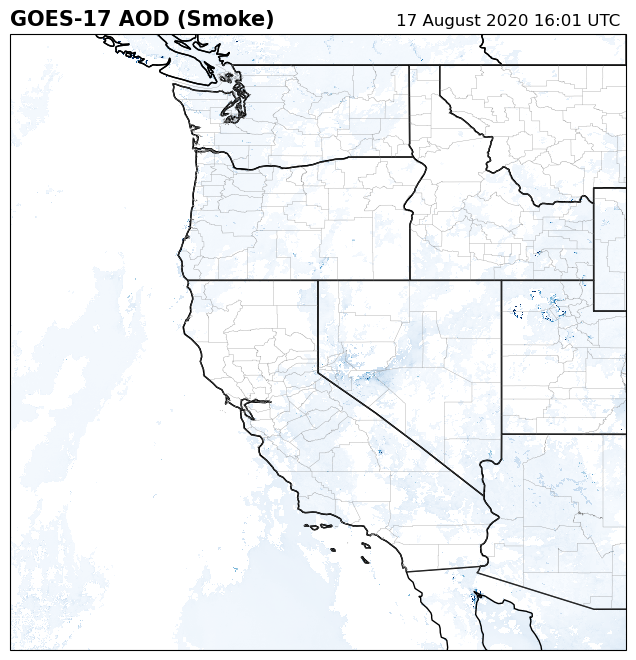

ABI-L2-AODC/2020/230/20/OR_ABI-L2-AODC
230
ABI-L2-AODC/2020/230/20/OR_ABI-L2-AODC-M6_G17_s20202302001176_e20202302003549_c20202302005535.nc


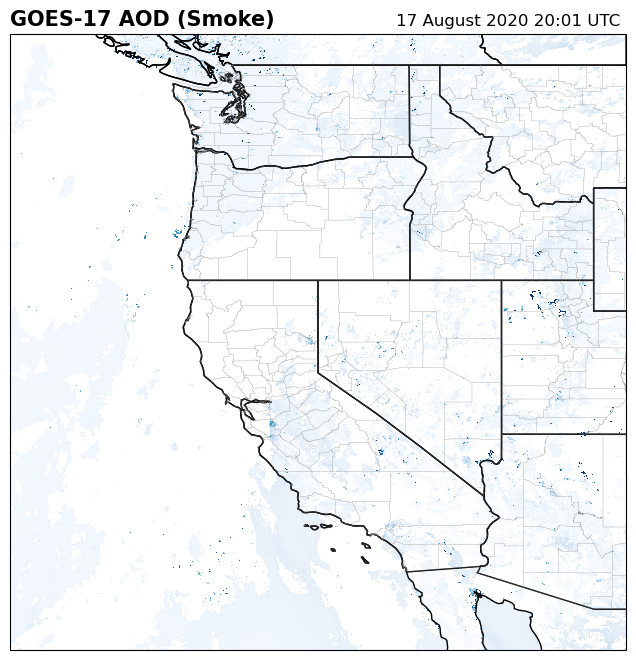

ABI-L2-AODC/2020/231/00/OR_ABI-L2-AODC
231
ABI-L2-AODC/2020/231/00/OR_ABI-L2-AODC-M6_G17_s20202310001176_e20202310003549_c20202310005145.nc


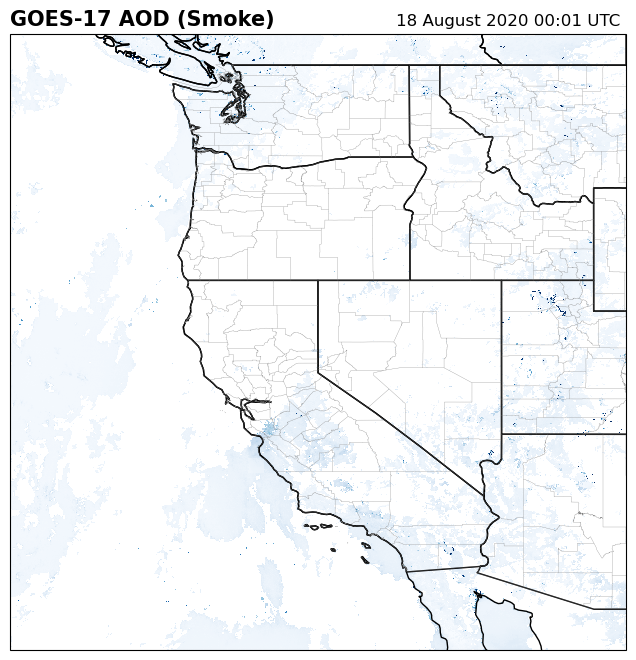

ABI-L2-AODC/2020/231/16/OR_ABI-L2-AODC
231
ABI-L2-AODC/2020/231/16/OR_ABI-L2-AODC-M6_G17_s20202311601176_e20202311603549_c20202311605113.nc


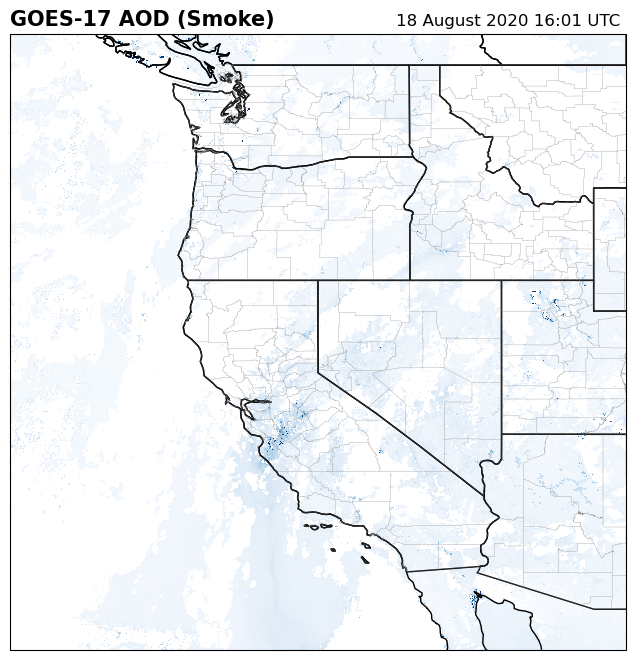

ABI-L2-AODC/2020/231/20/OR_ABI-L2-AODC
231
ABI-L2-AODC/2020/231/20/OR_ABI-L2-AODC-M6_G17_s20202312001176_e20202312003549_c20202312005548.nc


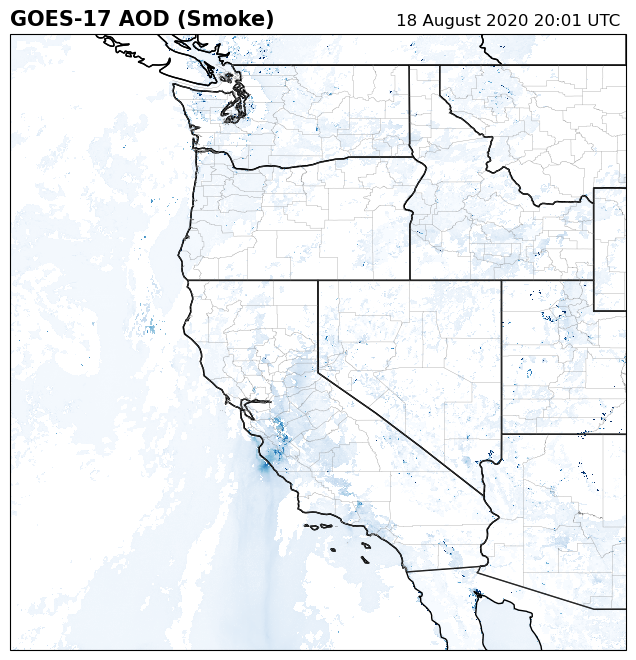

ABI-L2-AODC/2020/232/00/OR_ABI-L2-AODC
232
ABI-L2-AODC/2020/232/00/OR_ABI-L2-AODC-M6_G17_s20202320001177_e20202320003550_c20202320005272.nc


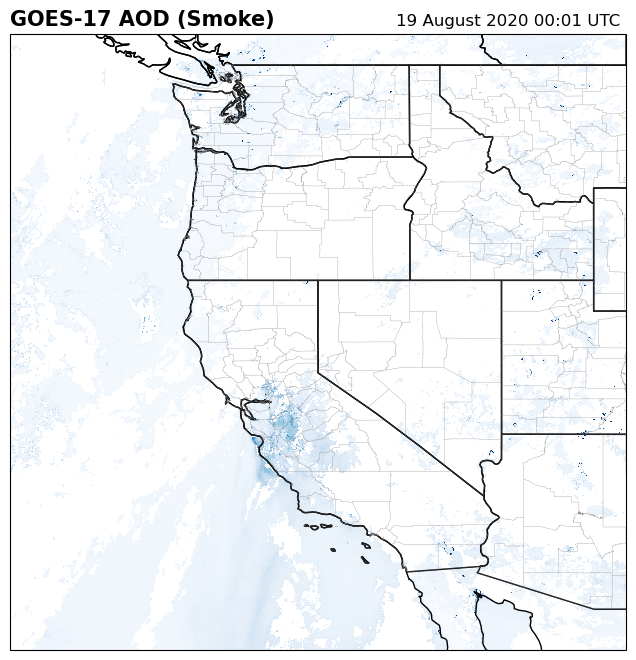

ABI-L2-AODC/2020/232/16/OR_ABI-L2-AODC
232
ABI-L2-AODC/2020/232/16/OR_ABI-L2-AODC-M6_G17_s20202321601176_e20202321603549_c20202321605230.nc


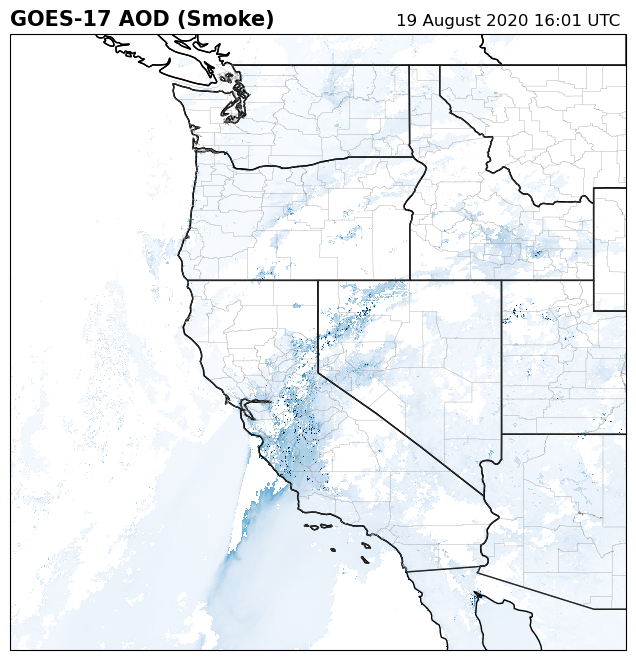

ABI-L2-AODC/2020/232/20/OR_ABI-L2-AODC
232
ABI-L2-AODC/2020/232/20/OR_ABI-L2-AODC-M6_G17_s20202322001176_e20202322003549_c20202322006083.nc


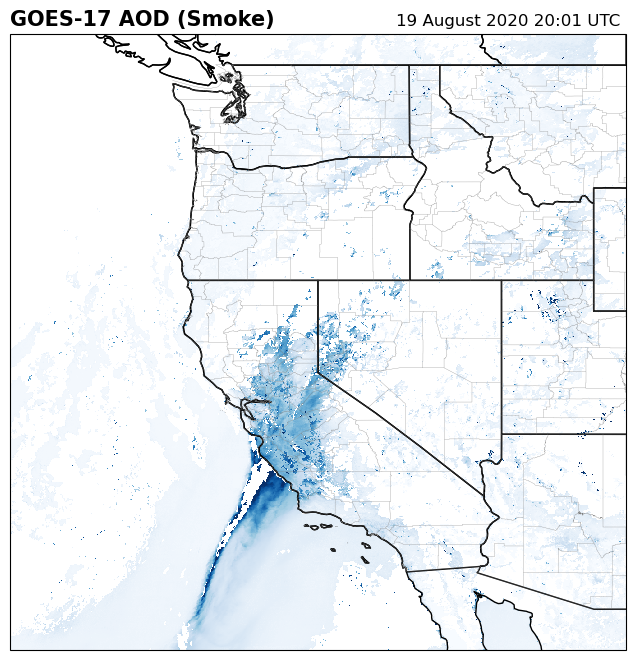

ABI-L2-AODC/2020/233/00/OR_ABI-L2-AODC
233
ABI-L2-AODC/2020/233/00/OR_ABI-L2-AODC-M6_G17_s20202330001176_e20202330003550_c20202330005430.nc


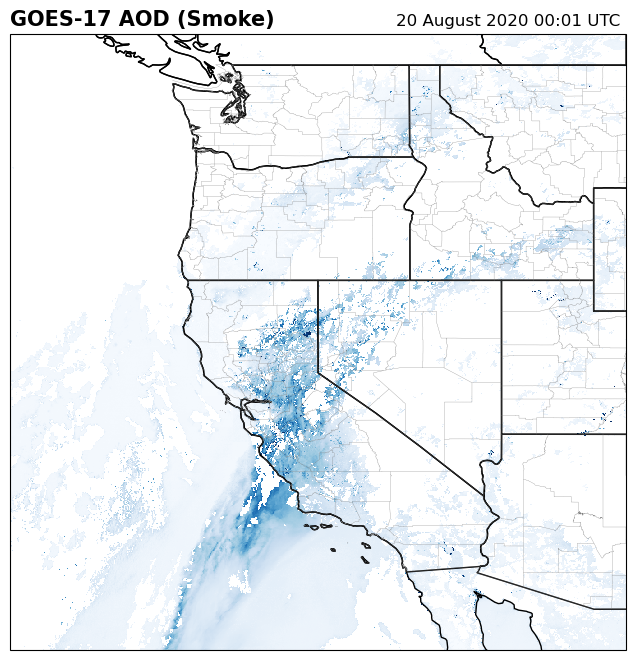

ABI-L2-AODC/2020/233/16/OR_ABI-L2-AODC
233
ABI-L2-AODC/2020/233/16/OR_ABI-L2-AODC-M6_G17_s20202331601176_e20202331603549_c20202331605265.nc


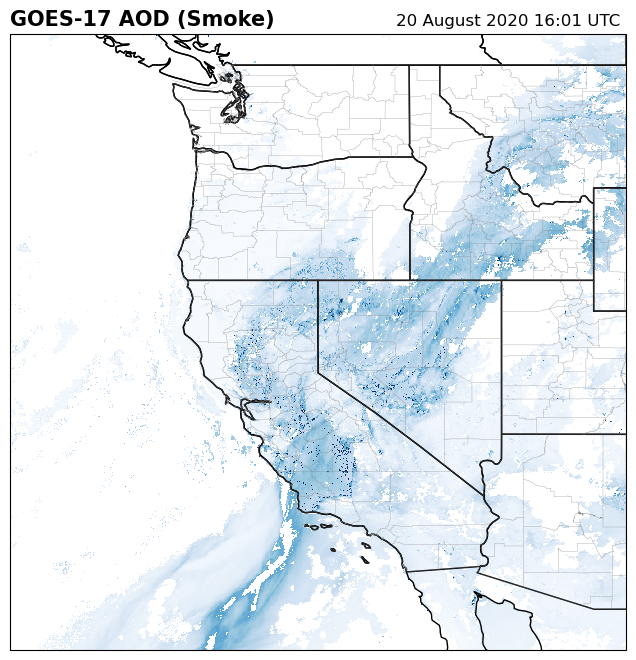

ABI-L2-AODC/2020/233/20/OR_ABI-L2-AODC
233
ABI-L2-AODC/2020/233/20/OR_ABI-L2-AODC-M6_G17_s20202332001176_e20202332003549_c20202332005461.nc


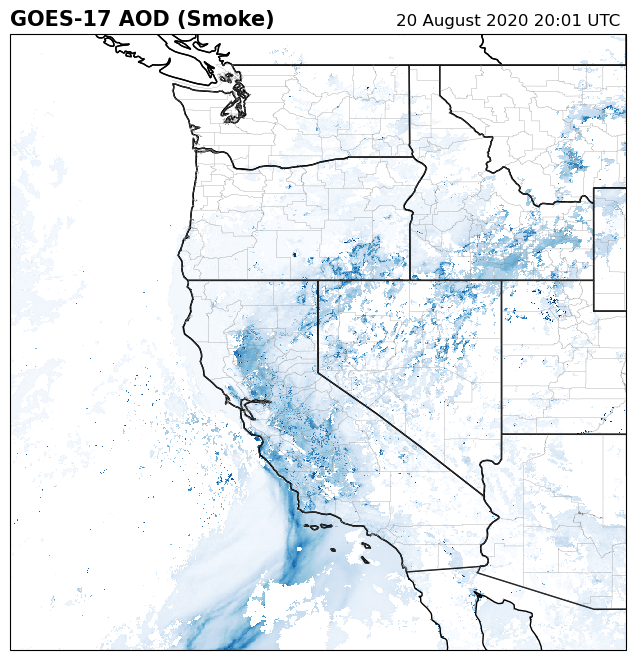

In [21]:
reader = shpreader.Reader('countyl010g_shp/countyl010g.shp')
counties = list(reader.geometries())
COUNTIES = cfeature.ShapelyFeature(counties, ccrs.PlateCarree())
gamma = 2.2

for day_of_year in range(229,234):
    for hour in [0,16,20]:
        bucket_name = 'noaa-goes17'
        product_name = 'ABI-L2-AODC'
        year = 2020
        #day_of_year = 239
        #hour = 1
        #band = 8

        prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}'
        keys = get_s3_keys(bucket_name,
                        s3_client,
                        prefix = prefix,
                        #prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6'
                        )
        print(prefix)
        print(day_of_year)
        try:
            key = [key for key in keys][0] # selecting the first measurement taken within the hour
            print(key)
            resp = requests.get(f'https://{bucket_name}.s3.amazonaws.com/{key}')

            file_name = key.split('/')[-1].split('.')[0]
            nc4_ds = netCDF4.Dataset(file_name, memory = resp.content)
            store = xr.backends.NetCDF4DataStore(nc4_ds)
            DS = xr.open_dataset(store)
            C = DS

            # Scan's start time, converted to datetime object
            scan_start = datetime.strptime(C.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')

            # Scan's end time, converted to datetime object
            scan_end = datetime.strptime(C.time_coverage_end, '%Y-%m-%dT%H:%M:%S.%fZ')

            # File creation time, convert to datetime object
            file_created = datetime.strptime(C.date_created, '%Y-%m-%dT%H:%M:%S.%fZ')


            R = C['AOD'].data
            G = C['AOD'].data
            B = C['AOD'].data


            G_true = 0.45 * R + 0.1 * G + 0.45 * B
            G_true = np.clip(G_true, 0, 1)  # apply limits again, just in case.

            # The RGB array with the raw veggie band
            RGB_veggie = np.dstack([R, G, B])

            # The RGB array for the true color image
            RGB = np.dstack([R, G_true, B])
            #RGB = np.dstack([I, I, I])

            # We'll use the `CMI_C02` variable as a 'hook' to get the CF metadata.
            dat = C.metpy.parse_cf('AOD')

            geos = dat.metpy.cartopy_crs

            # We also need the x (north/south) and y (east/west) axis sweep of the ABI data
            x = dat.x
            y = dat.y

            fig = plt.figure(figsize=(8, 8))

            pc = ccrs.PlateCarree()

            ax = fig.add_subplot(1, 1, 1, projection=pc)
            ax.set_extent([-130,-110,30,50], crs=pc)

            ax.imshow(R, origin='upper',
                    extent=(x.min(), x.max(), y.min(), y.max()),
                    transform=geos,
                    interpolation='none',
                    cmap = "Blues")

            ax.coastlines(resolution='50m', color='black', linewidth=1)
            ax.add_feature(ccrs.cartopy.feature.STATES)
            ax.add_feature(COUNTIES, facecolor='none', edgecolor='gray',linewidth=0.2)
            

            plt.title('GOES-17 AOD (Smoke)', loc='left', fontweight='bold', fontsize=15)
            plt.title('{}'.format(scan_start.strftime('%d %B %Y %H:%M UTC ')), loc='right')

            plt.show()
        except:
            print("failed")



# Plot Fire Map

ABI-L2-FDCC/2020/229/00/OR_ABI-L2-FDCC
229
ABI-L2-FDCC/2020/229/00/OR_ABI-L2-FDCC-M6_G17_s20202290001177_e20202290003550_c20202290004121.nc


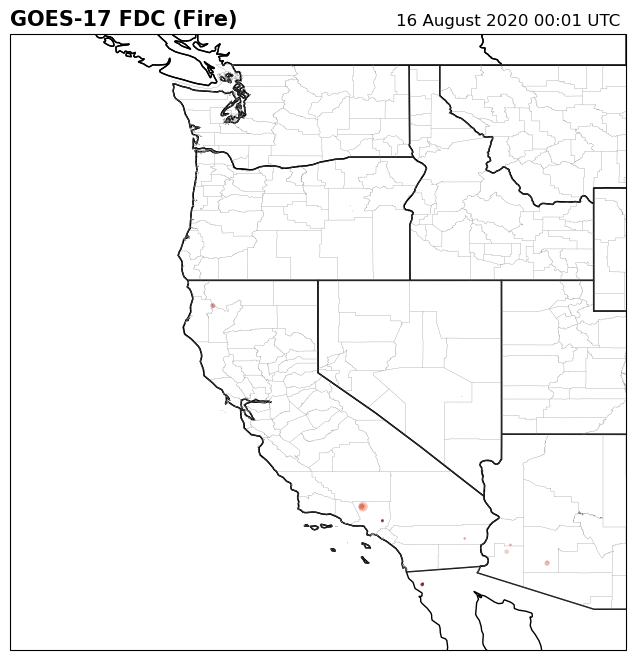

ABI-L2-FDCC/2020/229/16/OR_ABI-L2-FDCC
229
ABI-L2-FDCC/2020/229/16/OR_ABI-L2-FDCC-M6_G17_s20202291601176_e20202291603549_c20202291604125.nc


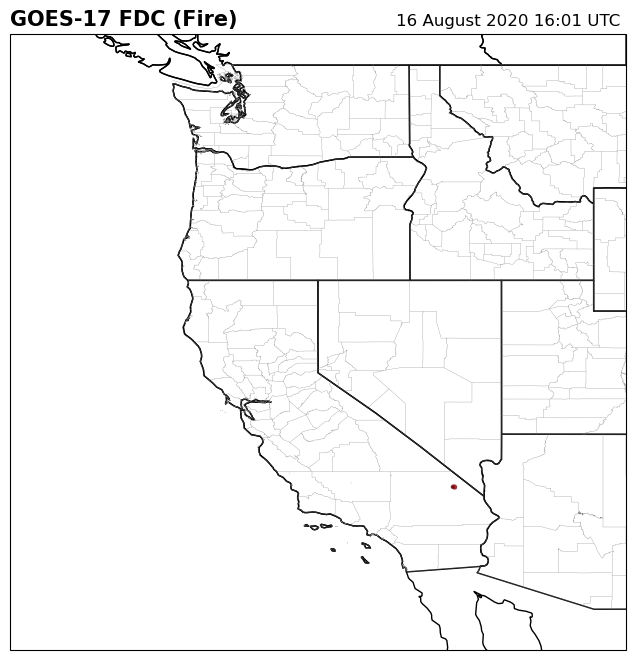

ABI-L2-FDCC/2020/229/20/OR_ABI-L2-FDCC
229
ABI-L2-FDCC/2020/229/20/OR_ABI-L2-FDCC-M6_G17_s20202292001176_e20202292003549_c20202292004133.nc


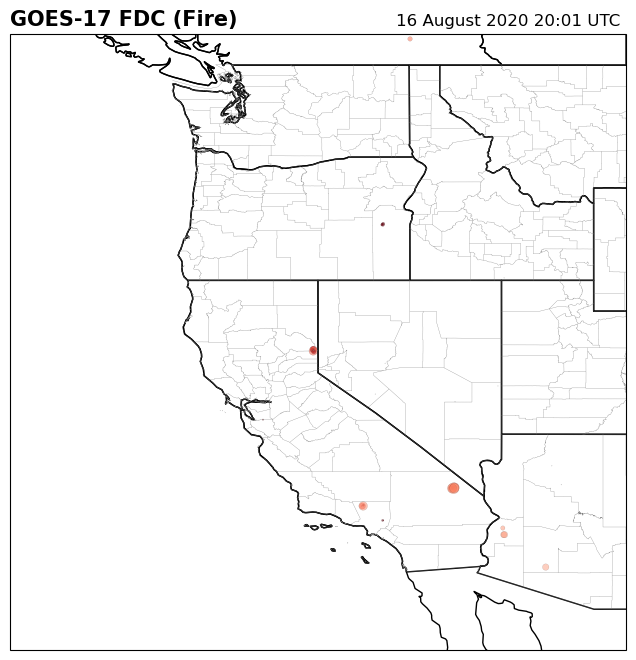

ABI-L2-FDCC/2020/230/00/OR_ABI-L2-FDCC
230
ABI-L2-FDCC/2020/230/00/OR_ABI-L2-FDCC-M6_G17_s20202300001176_e20202300003549_c20202300004120.nc


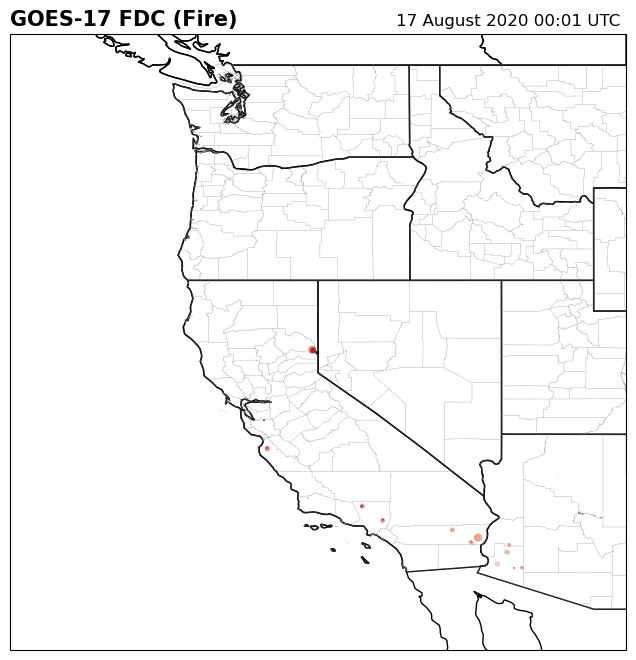

ABI-L2-FDCC/2020/230/16/OR_ABI-L2-FDCC
230
ABI-L2-FDCC/2020/230/16/OR_ABI-L2-FDCC-M6_G17_s20202301601176_e20202301603549_c20202301604127.nc


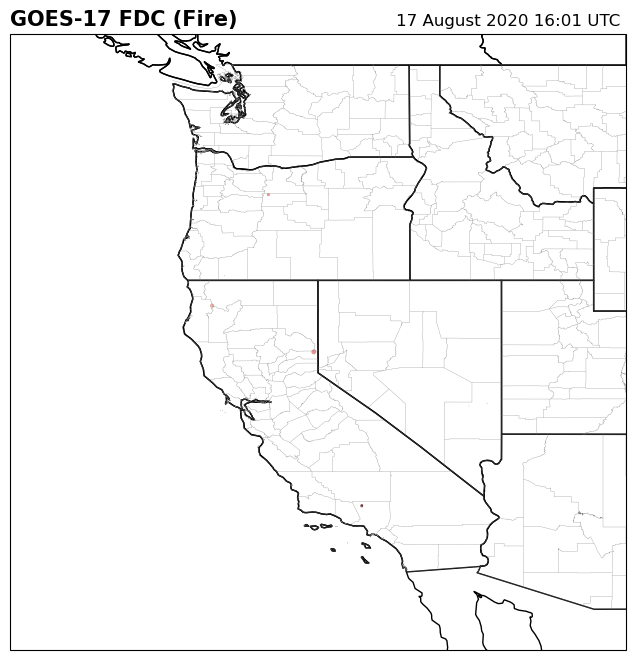

ABI-L2-FDCC/2020/230/20/OR_ABI-L2-FDCC
230
ABI-L2-FDCC/2020/230/20/OR_ABI-L2-FDCC-M6_G17_s20202302001176_e20202302003549_c20202302004118.nc


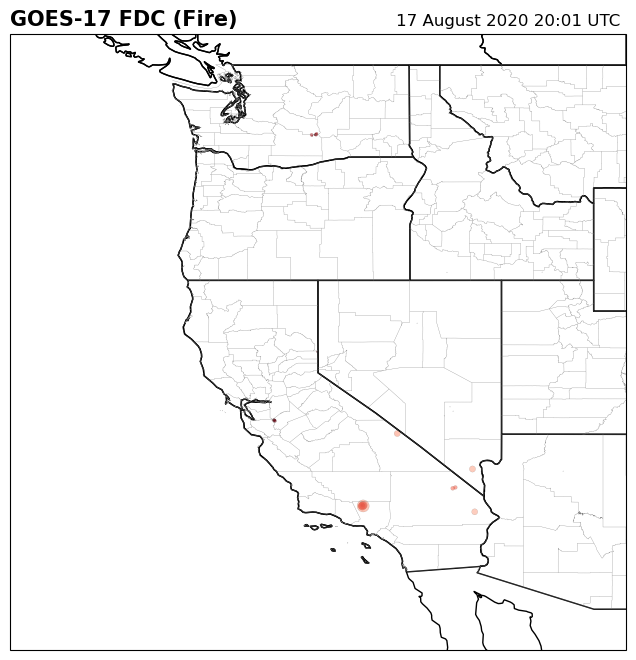

ABI-L2-FDCC/2020/231/00/OR_ABI-L2-FDCC
231
ABI-L2-FDCC/2020/231/00/OR_ABI-L2-FDCC-M6_G17_s20202310001176_e20202310003549_c20202310004107.nc


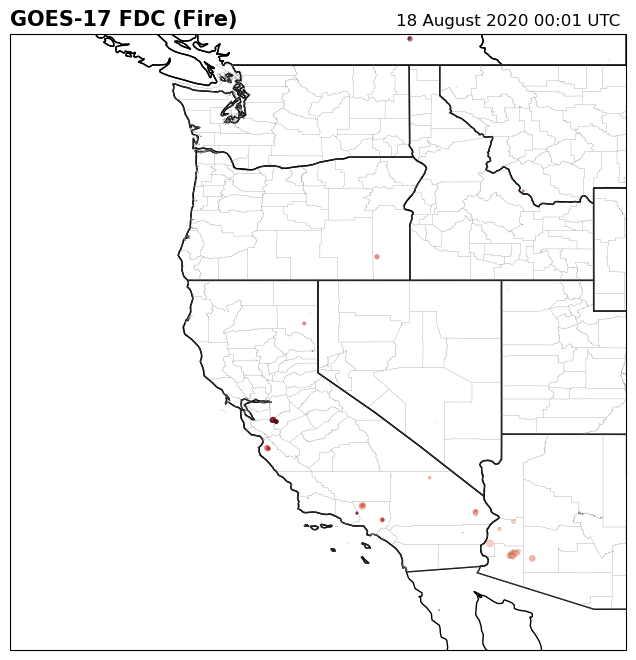

ABI-L2-FDCC/2020/231/16/OR_ABI-L2-FDCC
231
ABI-L2-FDCC/2020/231/16/OR_ABI-L2-FDCC-M6_G17_s20202311601176_e20202311603549_c20202311604112.nc


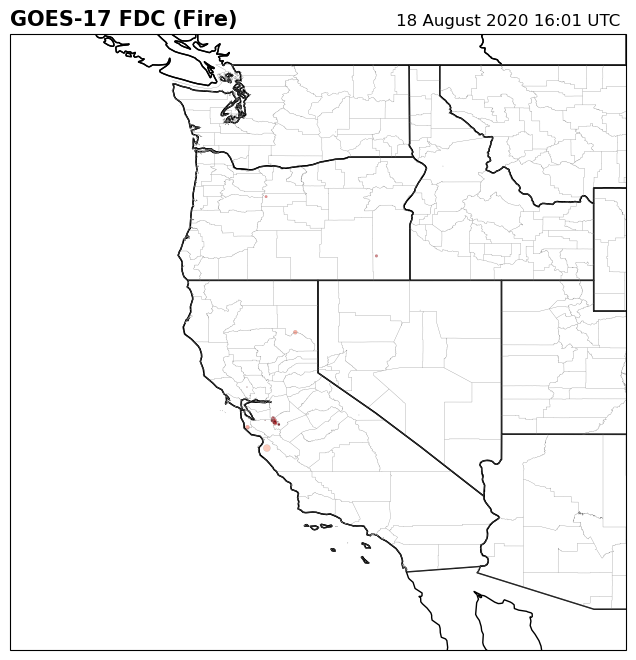

ABI-L2-FDCC/2020/231/20/OR_ABI-L2-FDCC
231
ABI-L2-FDCC/2020/231/20/OR_ABI-L2-FDCC-M6_G17_s20202312001176_e20202312003549_c20202312004113.nc


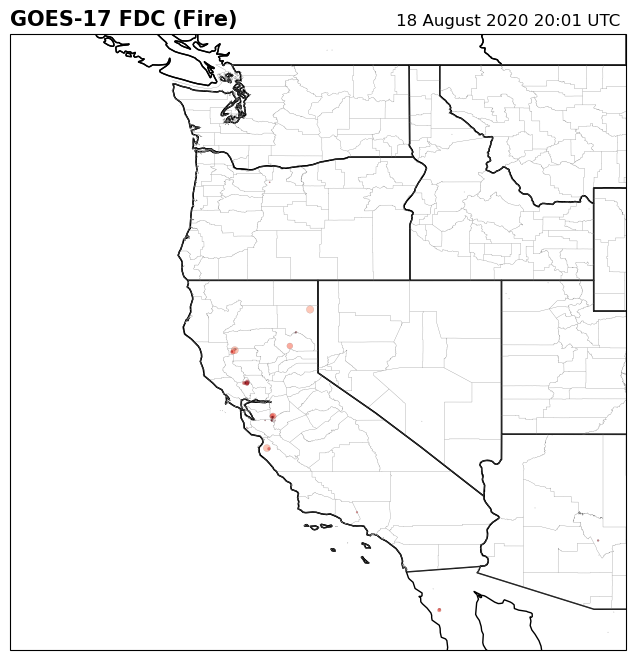

ABI-L2-FDCC/2020/232/00/OR_ABI-L2-FDCC
232
ABI-L2-FDCC/2020/232/00/OR_ABI-L2-FDCC-M6_G17_s20202320001177_e20202320003550_c20202320004115.nc


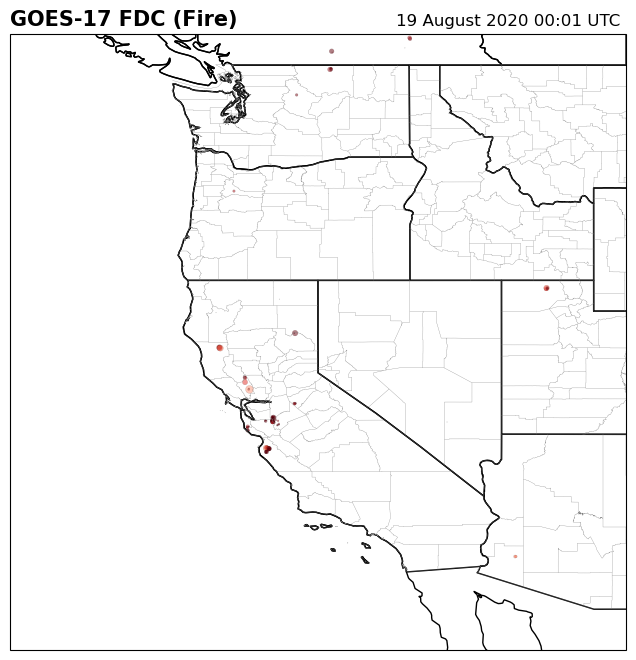

ABI-L2-FDCC/2020/232/16/OR_ABI-L2-FDCC
232
ABI-L2-FDCC/2020/232/16/OR_ABI-L2-FDCC-M6_G17_s20202321601176_e20202321603549_c20202321604138.nc


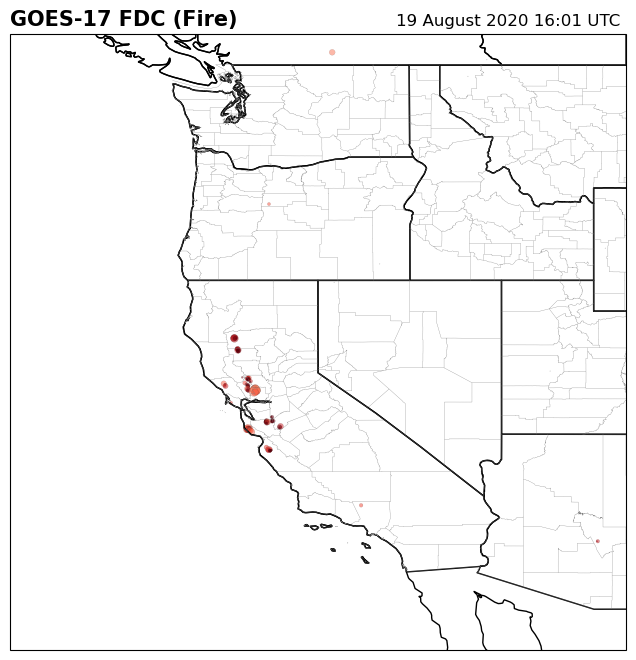

ABI-L2-FDCC/2020/232/20/OR_ABI-L2-FDCC
232
ABI-L2-FDCC/2020/232/20/OR_ABI-L2-FDCC-M6_G17_s20202322001176_e20202322003549_c20202322004134.nc


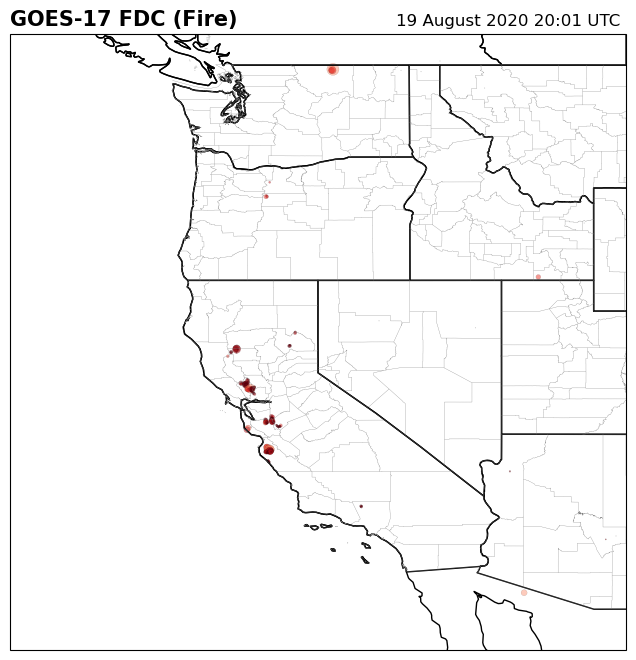

ABI-L2-FDCC/2020/233/00/OR_ABI-L2-FDCC
233
ABI-L2-FDCC/2020/233/00/OR_ABI-L2-FDCC-M6_G17_s20202330001176_e20202330003550_c20202330004110.nc


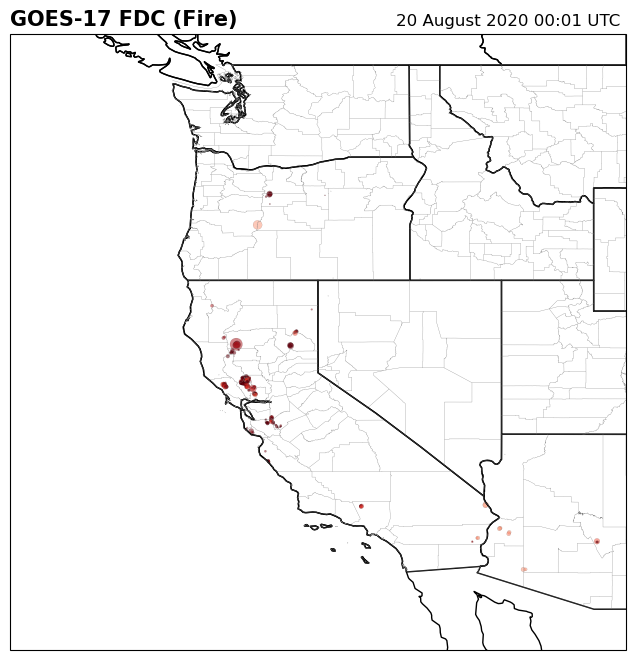

ABI-L2-FDCC/2020/233/16/OR_ABI-L2-FDCC
233
ABI-L2-FDCC/2020/233/16/OR_ABI-L2-FDCC-M6_G17_s20202331601176_e20202331603549_c20202331604129.nc


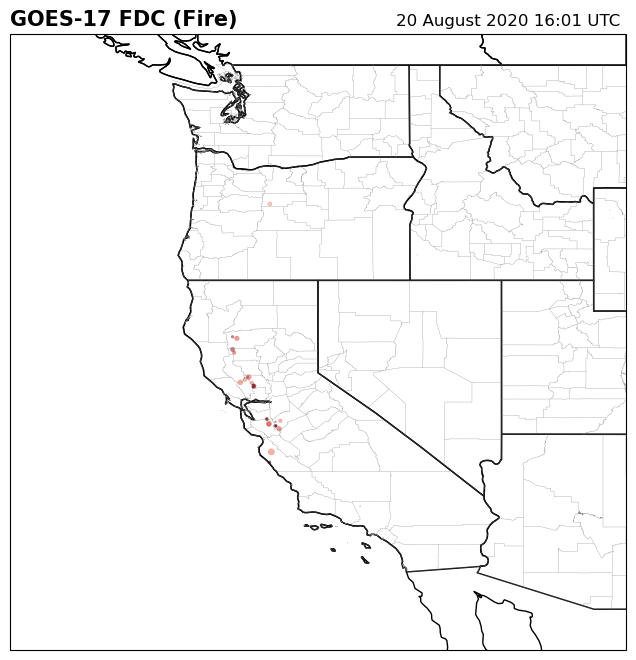

ABI-L2-FDCC/2020/233/20/OR_ABI-L2-FDCC
233
ABI-L2-FDCC/2020/233/20/OR_ABI-L2-FDCC-M6_G17_s20202332001176_e20202332003549_c20202332004108.nc


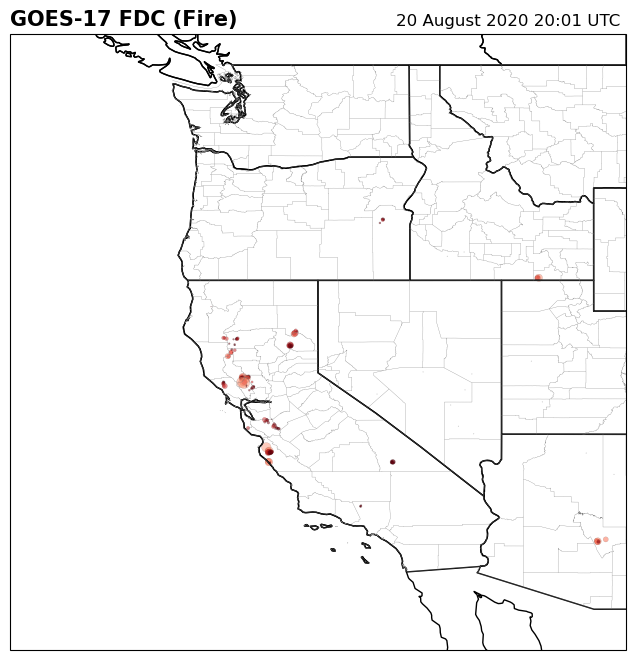

In [22]:
reader = shpreader.Reader('countyl010g_shp/countyl010g.shp')
counties = list(reader.geometries())
COUNTIES = cfeature.ShapelyFeature(counties, ccrs.PlateCarree())
gamma = 2.2

for day_of_year in range(229,234):
    for hour in [0,16,20]:
        bucket_name = 'noaa-goes17'
        product_name = 'ABI-L2-FDCC'
        year = 2020
        #day_of_year = 239
        #hour = 1
        #band = 8

        prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}'
        keys = get_s3_keys(bucket_name,
                        s3_client,
                        prefix = prefix,
                        #prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6'
                        )
        print(prefix)
        print(day_of_year)
        try:
            key = [key for key in keys][0] # selecting the first measurement taken within the hour
            print(key)
            resp = requests.get(f'https://{bucket_name}.s3.amazonaws.com/{key}')

            file_name = key.split('/')[-1].split('.')[0]
            nc4_ds = netCDF4.Dataset(file_name, memory = resp.content)
            store = xr.backends.NetCDF4DataStore(nc4_ds)
            DS = xr.open_dataset(store)
            C = DS

            # Scan's start time, converted to datetime object
            scan_start = datetime.strptime(C.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')

            # Scan's end time, converted to datetime object
            scan_end = datetime.strptime(C.time_coverage_end, '%Y-%m-%dT%H:%M:%S.%fZ')

            # File creation time, convert to datetime object
            file_created = datetime.strptime(C.date_created, '%Y-%m-%dT%H:%M:%S.%fZ')


            R = C['Temp'].data
            G = C['Area'].data
            B = C['Temp'].data


            # Calculate the "True" Green
            G_true = 0.45 * R + 0.1 * G + 0.45 * B
            G_true = np.clip(G_true, 0, 1)  # apply limits again, just in case.

            # The RGB array with the raw veggie band
            RGB_veggie = np.dstack([R, G, B])

            # The RGB array for the true color image
            RGB = np.dstack([R, G_true, B])
            #RGB = np.dstack([I, I, I])

            # We'll use the `CMI_C02` variable as a 'hook' to get the CF metadata.
            dat = C.metpy.parse_cf('Area')

            geos = dat.metpy.cartopy_crs

            # We also need the x (north/south) and y (east/west) axis sweep of the ABI data
            x = dat.x
            y = dat.y



            fig = plt.figure(figsize=(8, 8))

            pc = ccrs.PlateCarree()

            ax = fig.add_subplot(1, 1, 1, projection=pc)
            ax.set_extent([-130,-110,30,50], crs=pc)


            x, y = np.meshgrid(dat.x, dat.y)
            plt.scatter(x,y,s = G/10000, #origin='upper',
                    #extent=(x.min(), x.max(), y.min(), y.max()),
                    transform=geos,
                    #interpolation='none',
                    cmap = "Reds",
                    c = R, vmin = 300, vmax=600,
                    alpha = 0.5,
                    edgecolor='black', linewidth=0.1,
                    )

            ax.coastlines(resolution='50m', color='black', linewidth=1)
            ax.add_feature(ccrs.cartopy.feature.STATES)
            ax.add_feature(COUNTIES, facecolor='none', edgecolor='gray',linewidth=0.2)
            

            plt.title('GOES-17 FDC (Fire)', loc='left', fontweight='bold', fontsize=15)
            plt.title('{}'.format(scan_start.strftime('%d %B %Y %H:%M UTC ')), loc='right')

            plt.show()
        except:
            print("failed")



# Plot True Color Map

ABI-L2-MCMIPC/2020/229/00/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/00/OR_ABI-L2-MCMIPC-M6_G17_s20202290001177_e20202290003555_c20202290004085.nc


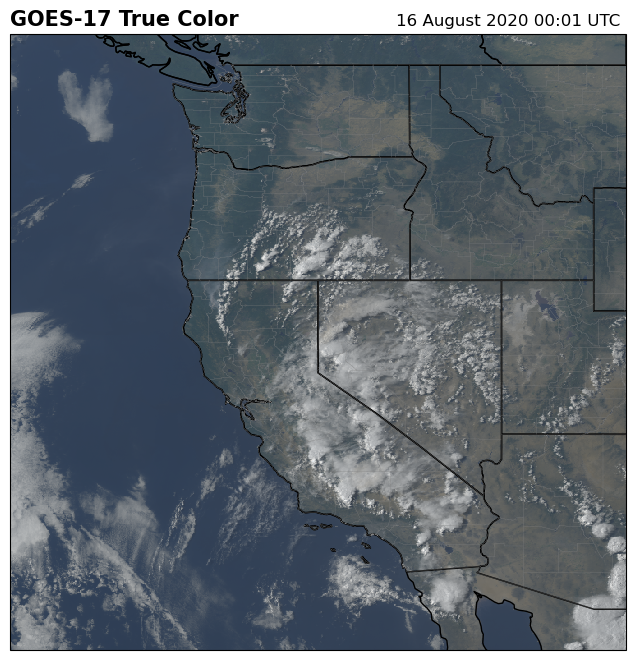

ABI-L2-MCMIPC/2020/229/16/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/16/OR_ABI-L2-MCMIPC-M6_G17_s20202291601176_e20202291603561_c20202291604092.nc


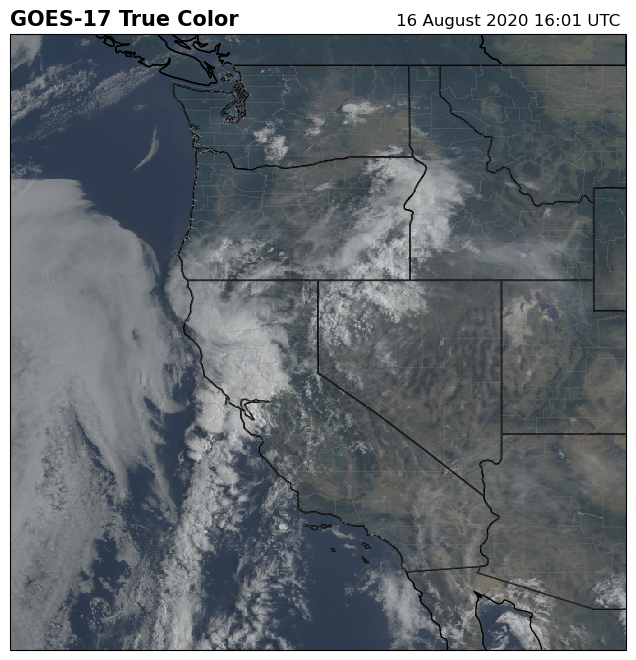

ABI-L2-MCMIPC/2020/229/20/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/20/OR_ABI-L2-MCMIPC-M6_G17_s20202292001176_e20202292003561_c20202292004092.nc


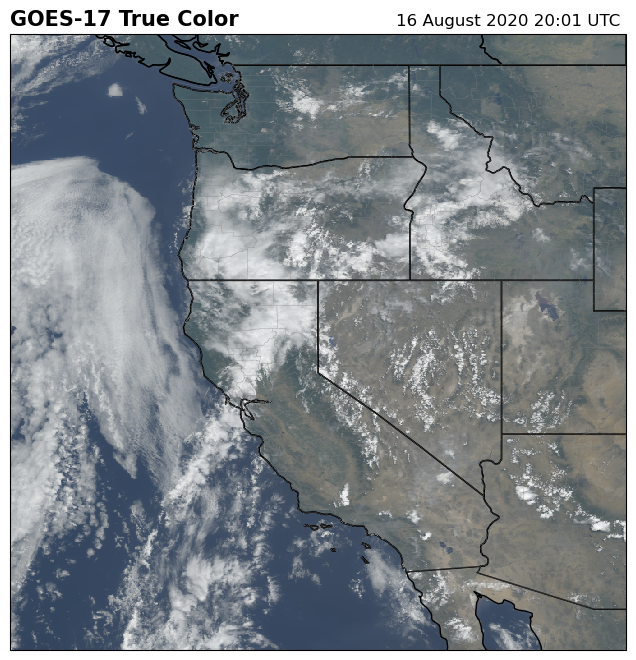

ABI-L2-MCMIPC/2020/230/00/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/00/OR_ABI-L2-MCMIPC-M6_G17_s20202300001176_e20202300003555_c20202300004092.nc


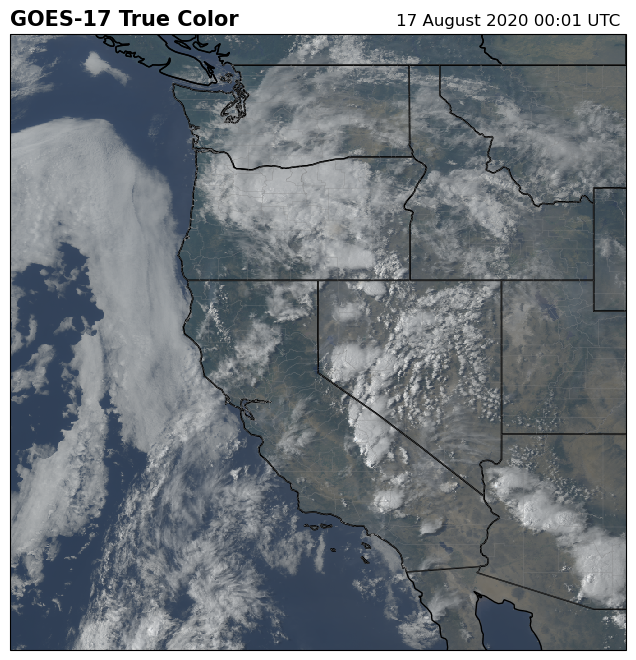

ABI-L2-MCMIPC/2020/230/16/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/16/OR_ABI-L2-MCMIPC-M6_G17_s20202301601176_e20202301603561_c20202301604092.nc


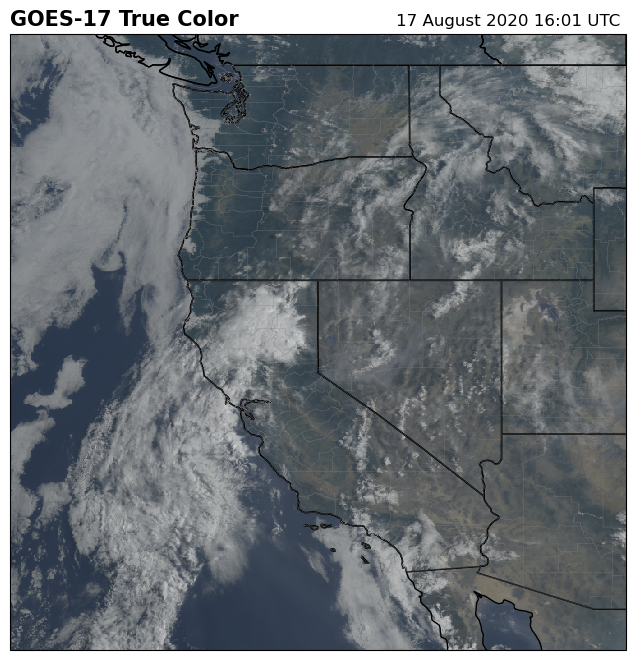

ABI-L2-MCMIPC/2020/230/20/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/20/OR_ABI-L2-MCMIPC-M6_G17_s20202302001176_e20202302003555_c20202302004087.nc


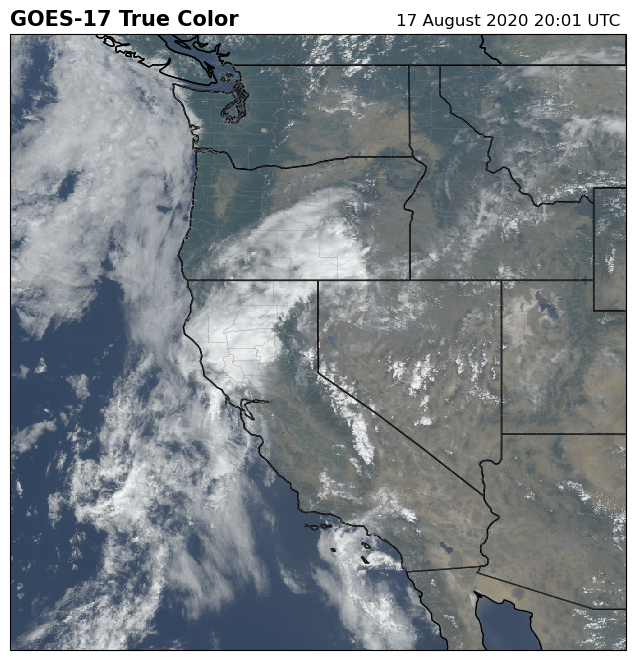

ABI-L2-MCMIPC/2020/231/00/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/00/OR_ABI-L2-MCMIPC-M6_G17_s20202310001176_e20202310003561_c20202310004084.nc


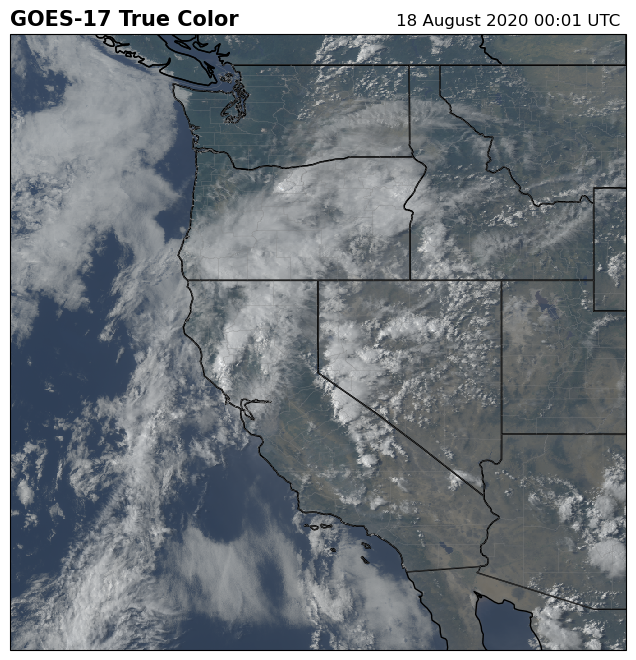

ABI-L2-MCMIPC/2020/231/16/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/16/OR_ABI-L2-MCMIPC-M6_G17_s20202311601176_e20202311603555_c20202311604088.nc


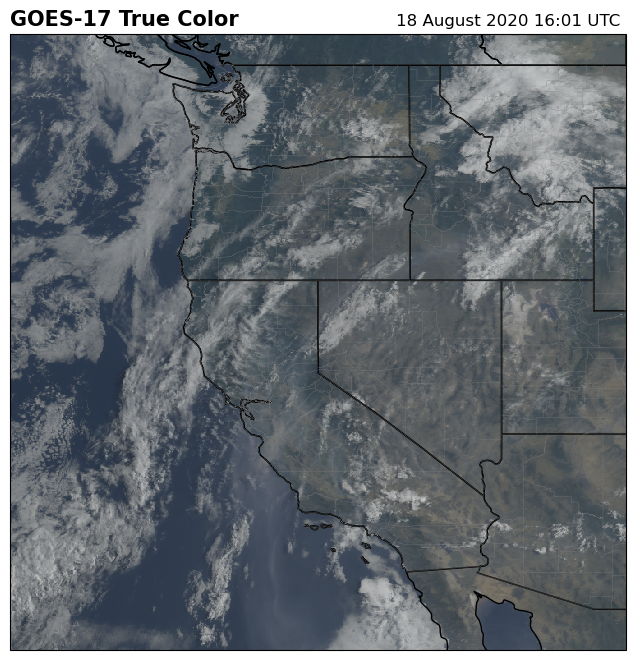

ABI-L2-MCMIPC/2020/231/20/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/20/OR_ABI-L2-MCMIPC-M6_G17_s20202312001176_e20202312003549_c20202312004096.nc


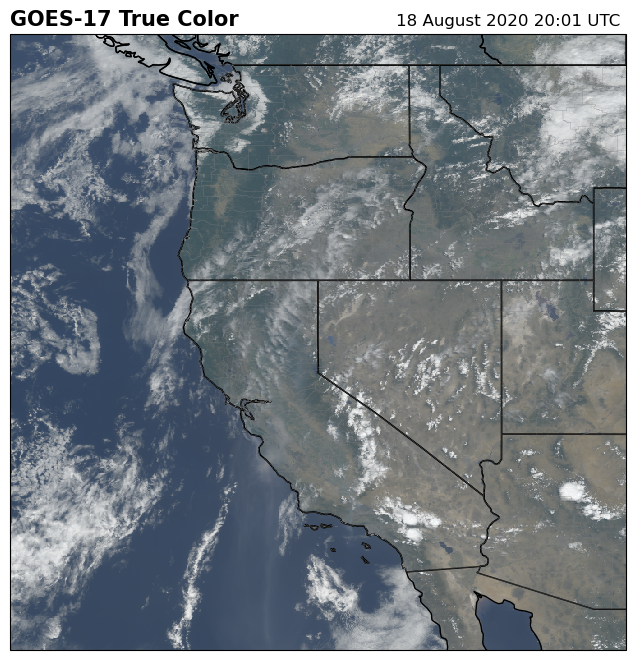

ABI-L2-MCMIPC/2020/232/00/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/00/OR_ABI-L2-MCMIPC-M6_G17_s20202320001177_e20202320003561_c20202320004076.nc


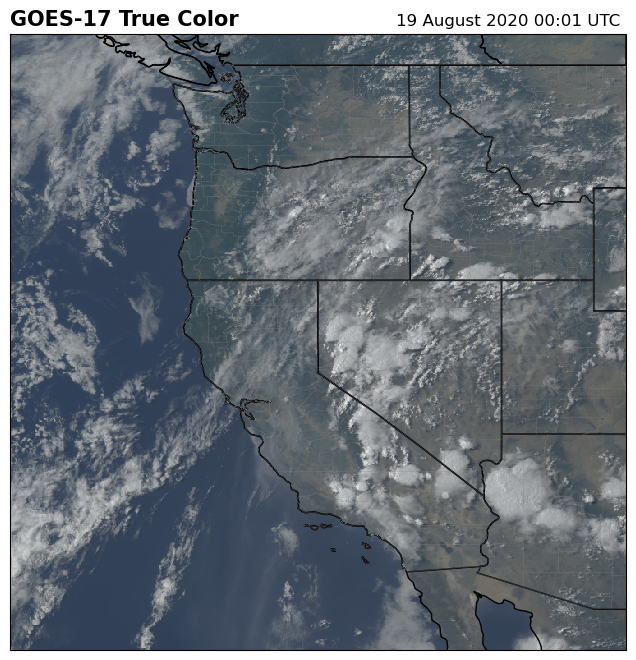

ABI-L2-MCMIPC/2020/232/16/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/16/OR_ABI-L2-MCMIPC-M6_G17_s20202321601176_e20202321603555_c20202321604085.nc


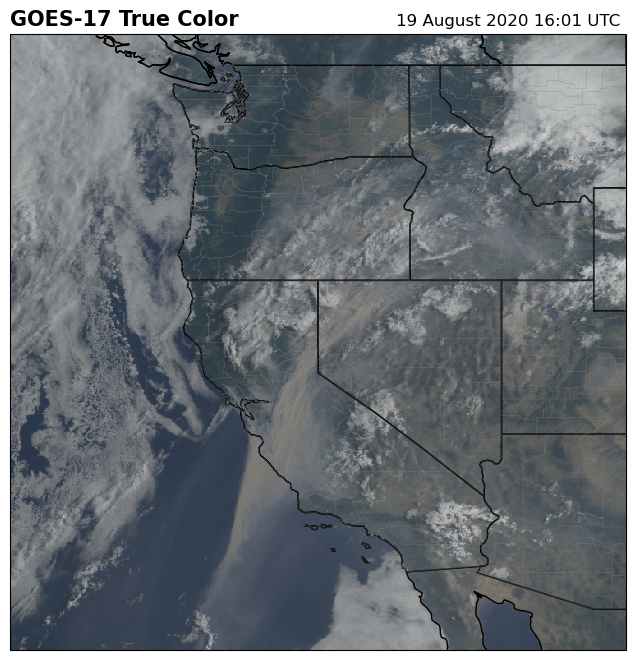

ABI-L2-MCMIPC/2020/232/20/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/20/OR_ABI-L2-MCMIPC-M6_G17_s20202322001176_e20202322003549_c20202322004097.nc


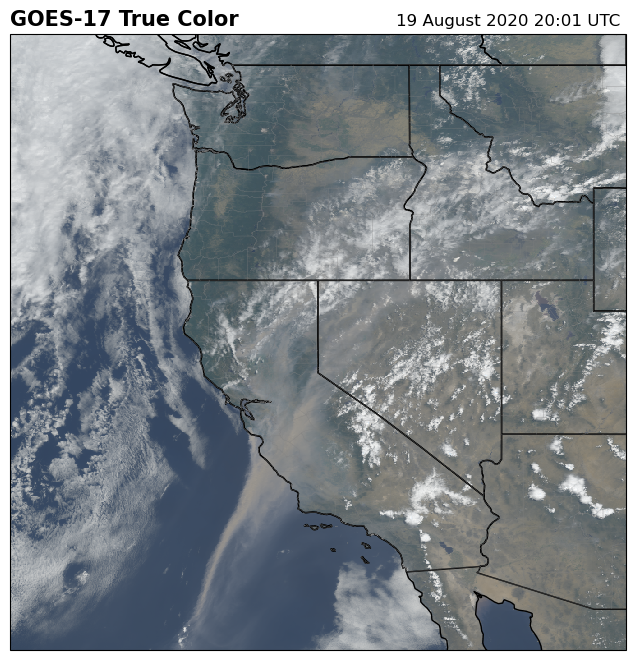

ABI-L2-MCMIPC/2020/233/00/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/00/OR_ABI-L2-MCMIPC-M6_G17_s20202330001176_e20202330003556_c20202330004091.nc


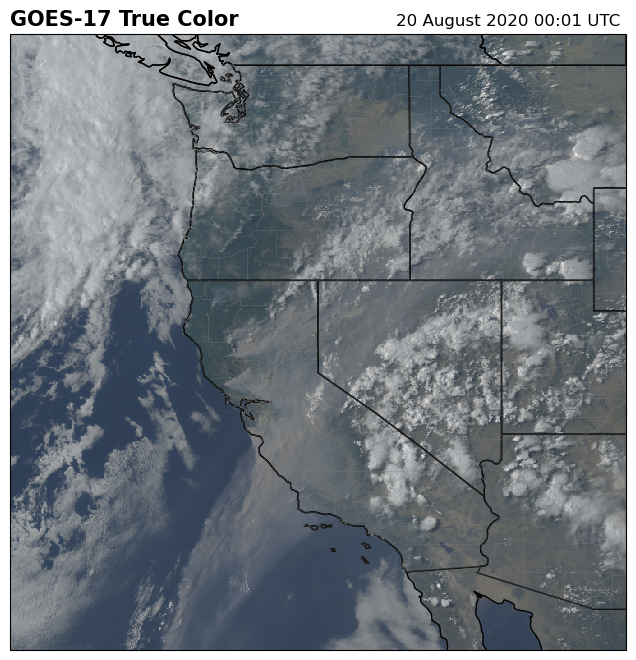

ABI-L2-MCMIPC/2020/233/16/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/16/OR_ABI-L2-MCMIPC-M6_G17_s20202331601176_e20202331603555_c20202331604083.nc


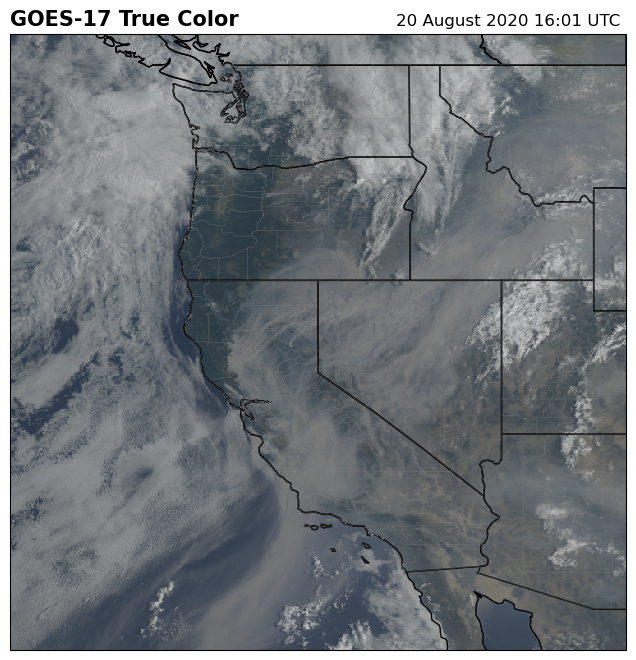

ABI-L2-MCMIPC/2020/233/20/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/20/OR_ABI-L2-MCMIPC-M6_G17_s20202332001176_e20202332003555_c20202332004087.nc


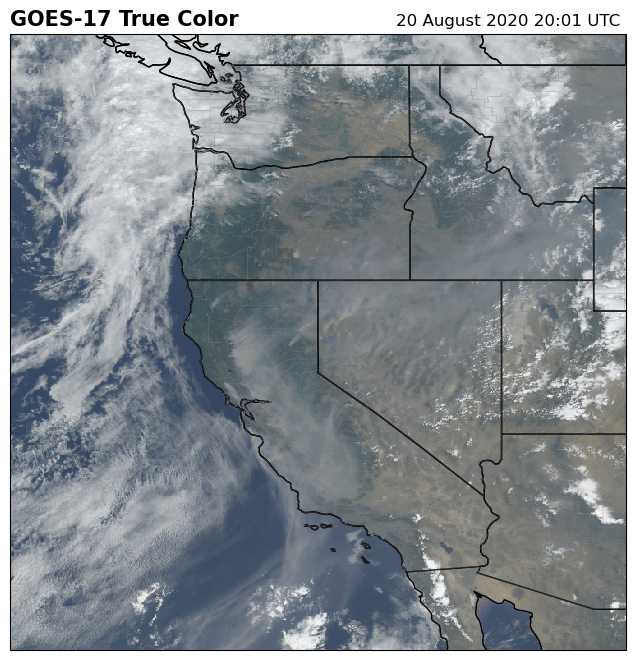

In [23]:
reader = shpreader.Reader('countyl010g_shp/countyl010g.shp')
counties = list(reader.geometries())
COUNTIES = cfeature.ShapelyFeature(counties, ccrs.PlateCarree())
gamma = 2.2

for day_of_year in range(229,234):
    for hour in [0,16,20]:
        bucket_name = 'noaa-goes17'
        product_name = 'ABI-L2-MCMIPC'
        year = 2020
        #day_of_year = 239
        #hour = 1
        #band = 8

        prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}'
        keys = get_s3_keys(bucket_name,
                        s3_client,
                        prefix = prefix,
                        #prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6'
                        )
        print(prefix)
        print(day_of_year)
        try:
            key = [key for key in keys][0] # selecting the first measurement taken within the hour
            print(key)
            resp = requests.get(f'https://{bucket_name}.s3.amazonaws.com/{key}')

            file_name = key.split('/')[-1].split('.')[0]
            nc4_ds = netCDF4.Dataset(file_name, memory = resp.content)
            store = xr.backends.NetCDF4DataStore(nc4_ds)
            DS = xr.open_dataset(store)
            C = DS

            # Scan's start time, converted to datetime object
            scan_start = datetime.strptime(C.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')

            # Scan's end time, converted to datetime object
            scan_end = datetime.strptime(C.time_coverage_end, '%Y-%m-%dT%H:%M:%S.%fZ')

            # File creation time, convert to datetime object
            file_created = datetime.strptime(C.date_created, '%Y-%m-%dT%H:%M:%S.%fZ')


            R = C['CMI_C02'].data
            G = C['CMI_C03'].data
            B = C['CMI_C01'].data

            R = np.clip(R, 0, 1)
            G = np.clip(G, 0, 1)
            B = np.clip(B, 0, 1)

            R = np.power(R, 1/gamma)
            G = np.power(G, 1/gamma)
            B = np.power(B, 1/gamma)

            # Calculate the "True" Green
            G_true = 0.45 * R + 0.1 * G + 0.45 * B
            G_true = np.clip(G_true, 0, 1)  # apply limits again, just in case.

            # The RGB array with the raw veggie band
            RGB_veggie = np.dstack([R, G, B])

            # The RGB array for the true color image
            RGB = np.dstack([R, G_true, B])
            #RGB = np.dstack([I, I, I])

            # We'll use the `CMI_C02` variable as a 'hook' to get the CF metadata.
            dat = C.metpy.parse_cf('CMI_C02')

            geos = dat.metpy.cartopy_crs

            # We also need the x (north/south) and y (east/west) axis sweep of the ABI data
            x = dat.x
            y = dat.y

            fig = plt.figure(figsize=(8, 8))

            pc = ccrs.PlateCarree()

            ax = fig.add_subplot(1, 1, 1, projection=pc)
            ax.set_extent([-130,-110,30,50], crs=pc)

            ax.imshow(RGB, origin='upper',
                    extent=(x.min(), x.max(), y.min(), y.max()),
                    transform=geos,
                    interpolation='none')

            ax.coastlines(resolution='50m', color='black', linewidth=1)
            ax.add_feature(ccrs.cartopy.feature.STATES)
            ax.add_feature(COUNTIES, facecolor='none', edgecolor='gray',linewidth=0.2)
            

            plt.title('GOES-17 True Color', loc='left', fontweight='bold', fontsize=15)
            plt.title('{}'.format(scan_start.strftime('%d %B %Y %H:%M UTC ')), loc='right')

            plt.show()
        except:
            print("failed")



# Plot Humidity Map

ABI-L2-MCMIPC/2020/229/00/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/00/OR_ABI-L2-MCMIPC-M6_G17_s20202290001177_e20202290003555_c20202290004085.nc


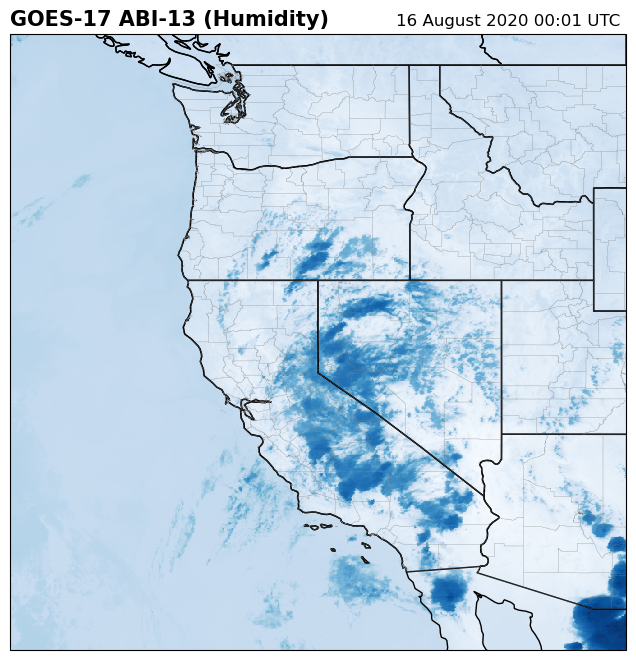

ABI-L2-MCMIPC/2020/229/16/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/16/OR_ABI-L2-MCMIPC-M6_G17_s20202291601176_e20202291603561_c20202291604092.nc


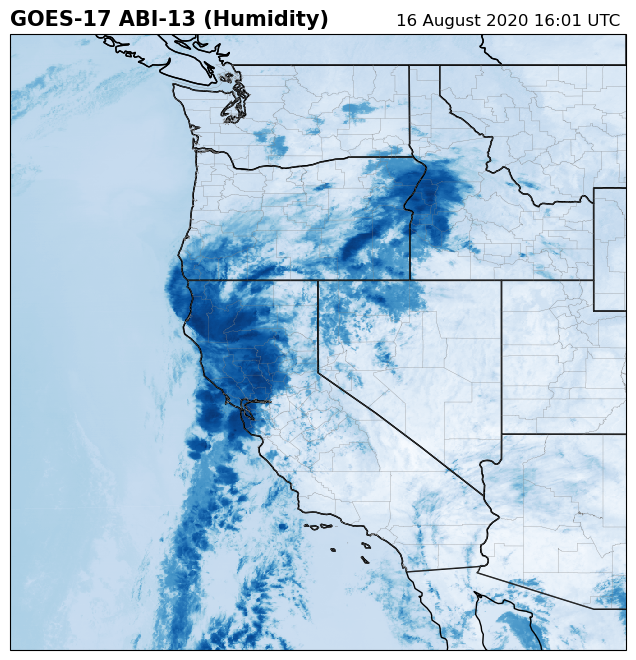

ABI-L2-MCMIPC/2020/229/20/OR_ABI-L2-MCMIPC
229
ABI-L2-MCMIPC/2020/229/20/OR_ABI-L2-MCMIPC-M6_G17_s20202292001176_e20202292003561_c20202292004092.nc


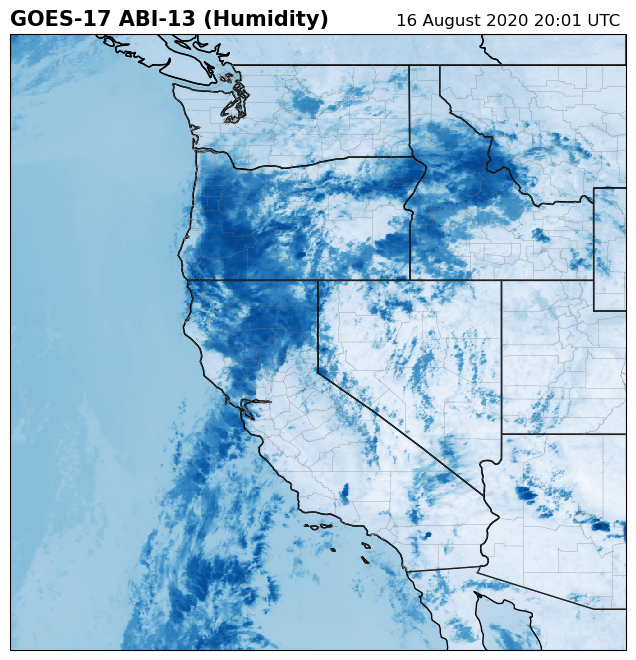

ABI-L2-MCMIPC/2020/230/00/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/00/OR_ABI-L2-MCMIPC-M6_G17_s20202300001176_e20202300003555_c20202300004092.nc


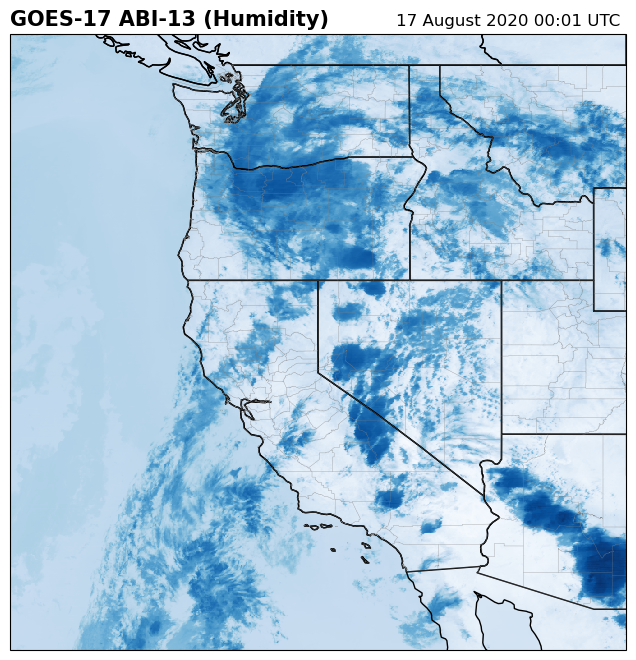

ABI-L2-MCMIPC/2020/230/16/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/16/OR_ABI-L2-MCMIPC-M6_G17_s20202301601176_e20202301603561_c20202301604092.nc


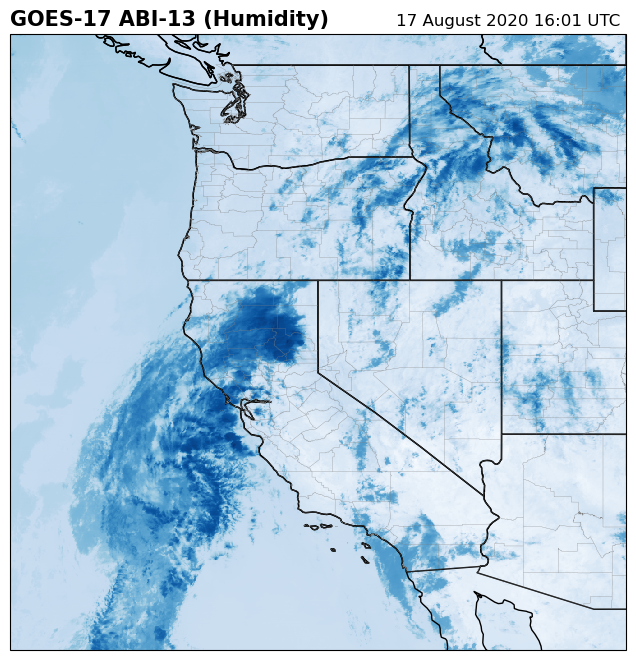

ABI-L2-MCMIPC/2020/230/20/OR_ABI-L2-MCMIPC
230
ABI-L2-MCMIPC/2020/230/20/OR_ABI-L2-MCMIPC-M6_G17_s20202302001176_e20202302003555_c20202302004087.nc


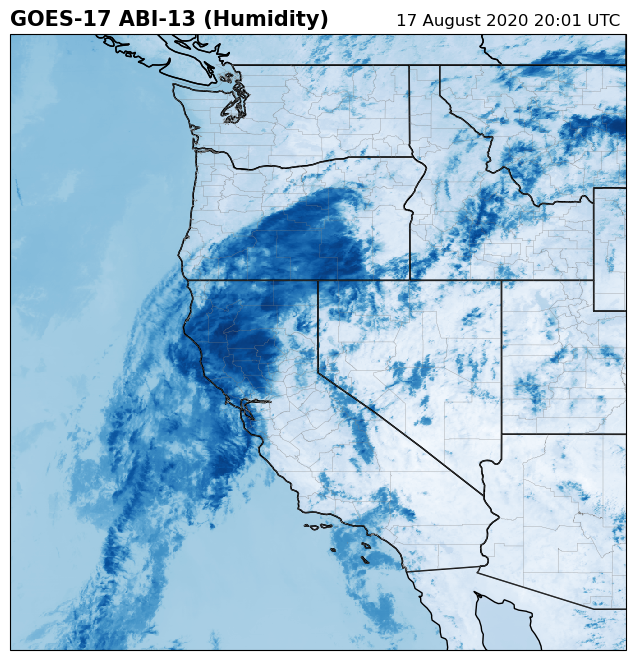

ABI-L2-MCMIPC/2020/231/00/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/00/OR_ABI-L2-MCMIPC-M6_G17_s20202310001176_e20202310003561_c20202310004084.nc


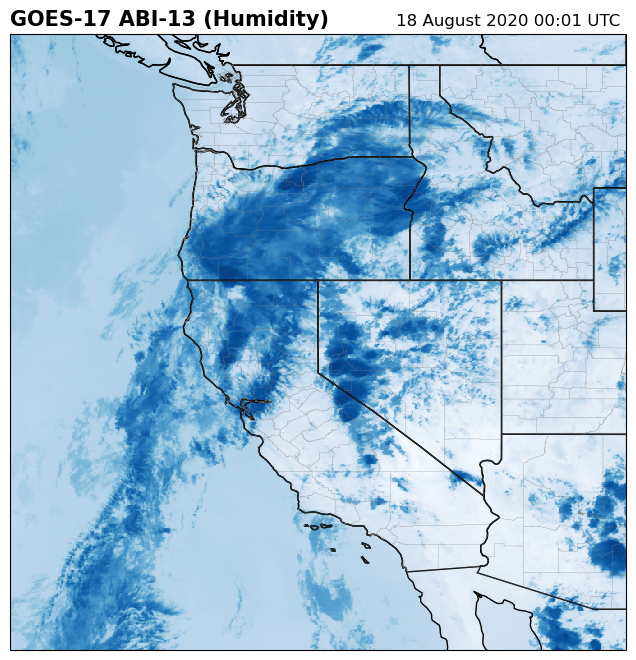

ABI-L2-MCMIPC/2020/231/16/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/16/OR_ABI-L2-MCMIPC-M6_G17_s20202311601176_e20202311603555_c20202311604088.nc


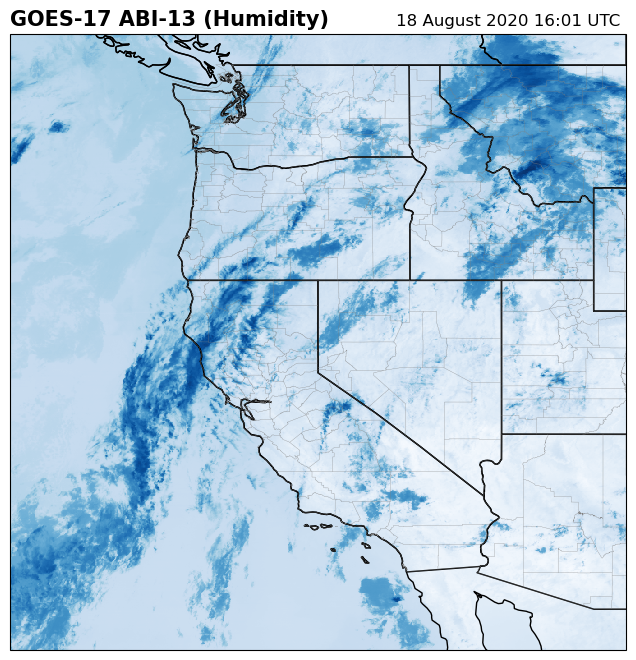

ABI-L2-MCMIPC/2020/231/20/OR_ABI-L2-MCMIPC
231
ABI-L2-MCMIPC/2020/231/20/OR_ABI-L2-MCMIPC-M6_G17_s20202312001176_e20202312003549_c20202312004096.nc


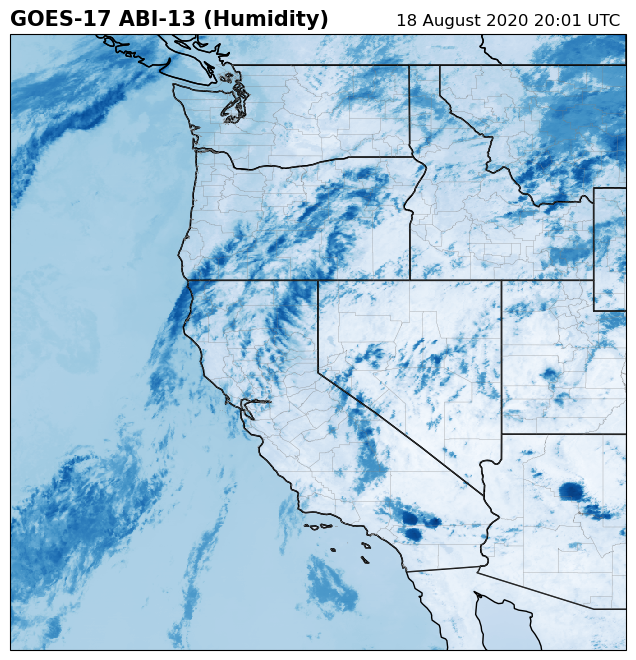

ABI-L2-MCMIPC/2020/232/00/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/00/OR_ABI-L2-MCMIPC-M6_G17_s20202320001177_e20202320003561_c20202320004076.nc


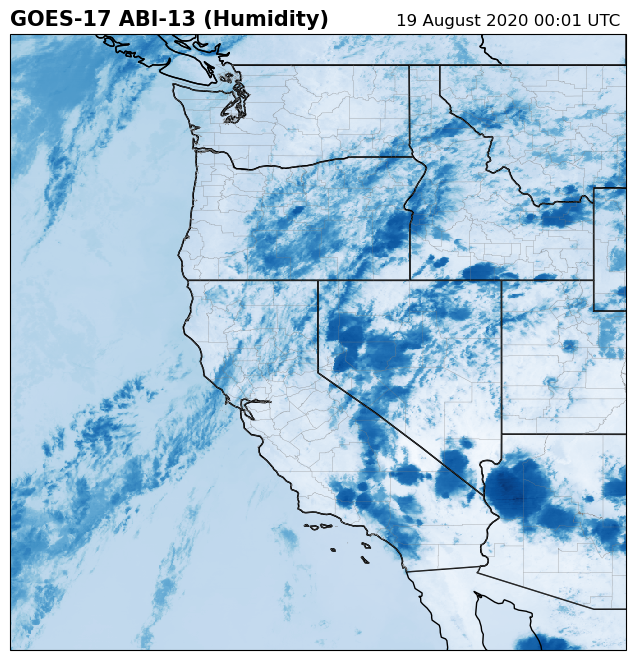

ABI-L2-MCMIPC/2020/232/16/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/16/OR_ABI-L2-MCMIPC-M6_G17_s20202321601176_e20202321603555_c20202321604085.nc


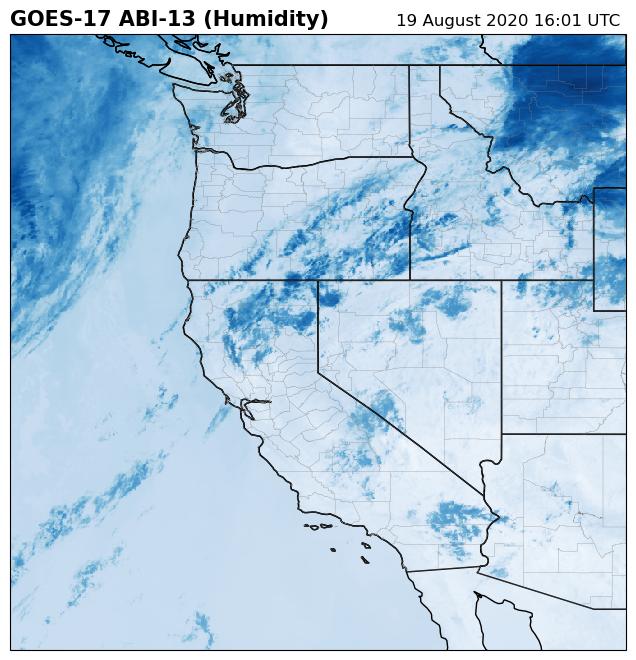

ABI-L2-MCMIPC/2020/232/20/OR_ABI-L2-MCMIPC
232
ABI-L2-MCMIPC/2020/232/20/OR_ABI-L2-MCMIPC-M6_G17_s20202322001176_e20202322003549_c20202322004097.nc


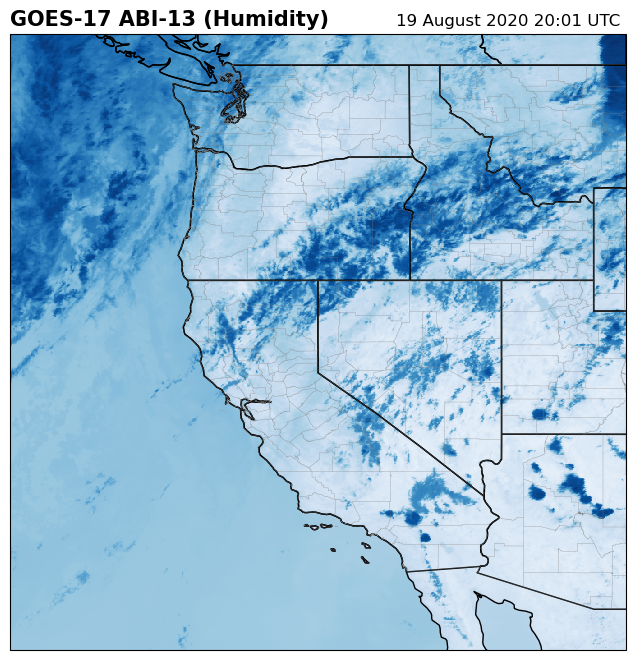

ABI-L2-MCMIPC/2020/233/00/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/00/OR_ABI-L2-MCMIPC-M6_G17_s20202330001176_e20202330003556_c20202330004091.nc


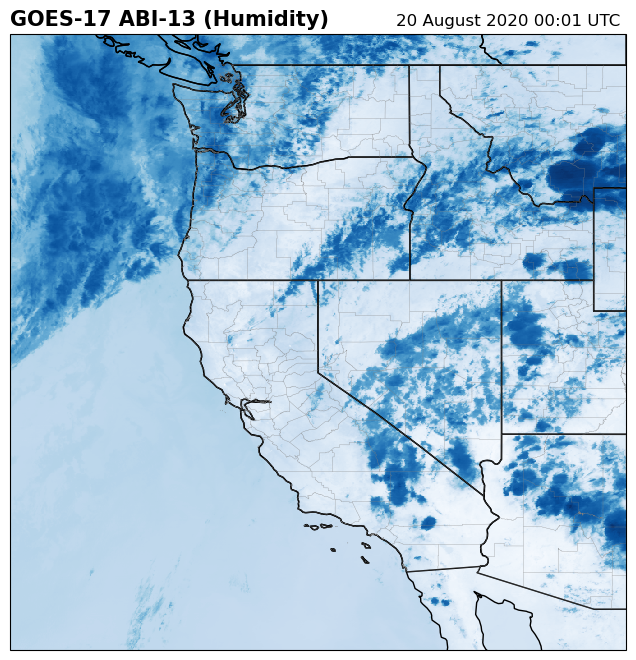

ABI-L2-MCMIPC/2020/233/16/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/16/OR_ABI-L2-MCMIPC-M6_G17_s20202331601176_e20202331603555_c20202331604083.nc


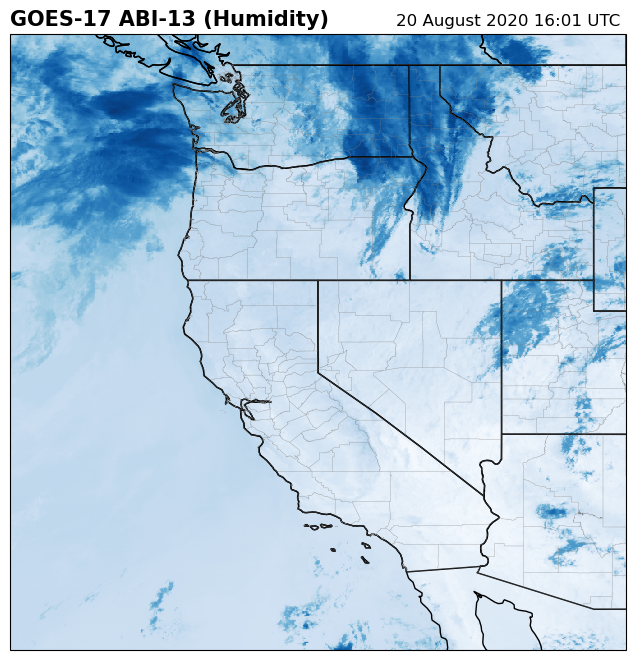

ABI-L2-MCMIPC/2020/233/20/OR_ABI-L2-MCMIPC
233
ABI-L2-MCMIPC/2020/233/20/OR_ABI-L2-MCMIPC-M6_G17_s20202332001176_e20202332003555_c20202332004087.nc


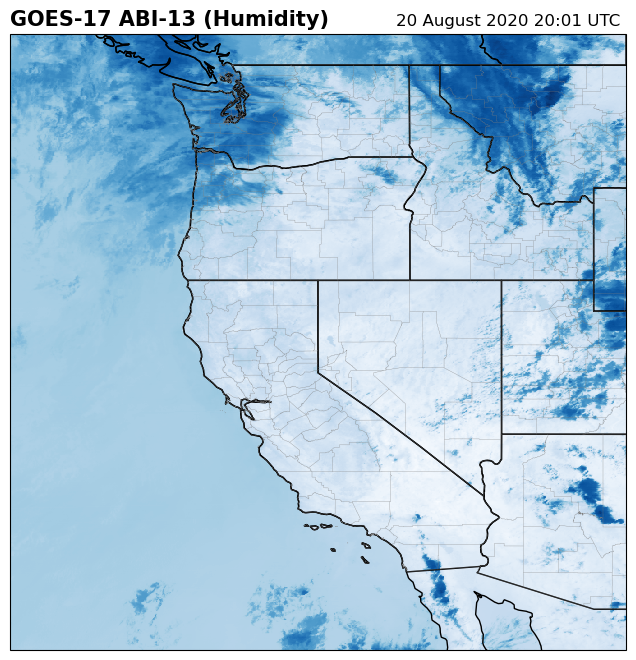

In [27]:
reader = shpreader.Reader('countyl010g_shp/countyl010g.shp')
counties = list(reader.geometries())
COUNTIES = cfeature.ShapelyFeature(counties, ccrs.PlateCarree())
channel_id = "CMI_C13"

gamma = 2.2

for day_of_year in range(229,234):
    for hour in [0,16,20]:
        bucket_name = 'noaa-goes17'
        product_name = 'ABI-L2-MCMIPC'
        year = 2020
        #day_of_year = 239
        #hour = 1
        #band = 8

        prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}'
        keys = get_s3_keys(bucket_name,
                        s3_client,
                        prefix = prefix,
                        #prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6'
                        )
        print(prefix)
        print(day_of_year)

        key = [key for key in keys][0] # selecting the first measurement taken within the hour
        print(key)
        resp = requests.get(f'https://{bucket_name}.s3.amazonaws.com/{key}')

        file_name = key.split('/')[-1].split('.')[0]
        nc4_ds = netCDF4.Dataset(file_name, memory = resp.content)
        store = xr.backends.NetCDF4DataStore(nc4_ds)
        DS = xr.open_dataset(store)
        C = DS

        # Scan's start time, converted to datetime object
        scan_start = datetime.strptime(C.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')

        # Scan's end time, converted to datetime object
        scan_end = datetime.strptime(C.time_coverage_end, '%Y-%m-%dT%H:%M:%S.%fZ')

        # File creation time, convert to datetime object
        file_created = datetime.strptime(C.date_created, '%Y-%m-%dT%H:%M:%S.%fZ')


        R = C[channel_id].data

        dat = C.metpy.parse_cf(channel_id)

        geos = dat.metpy.cartopy_crs

        # We also need the x (north/south) and y (east/west) axis sweep of the ABI data
        x = dat.x
        y = dat.y

        fig = plt.figure(figsize=(8, 8))

        pc = ccrs.PlateCarree()

        ax = fig.add_subplot(1, 1, 1, projection=pc)
        ax.set_extent([-130,-110,30,50], crs=pc)

        ax.imshow(R, origin='upper',
                extent=(x.min(), x.max(), y.min(), y.max()),
                transform=geos,
                interpolation='none',
                cmap = "Blues_r")

        ax.coastlines(resolution='50m', color='black', linewidth=1)
        ax.add_feature(ccrs.cartopy.feature.STATES)
        ax.add_feature(COUNTIES, facecolor='none', edgecolor='gray',linewidth=0.2)
        

        plt.title('GOES-17 ABI-13 (Humidity)', loc='left', fontweight='bold', fontsize=15)
        plt.title('{}'.format(scan_start.strftime('%d %B %Y %H:%M UTC ')), loc='right')

        plt.show()


